# Plot polar maps of boreal domain data 
Paul Montesano  
Fall 2022  
run this notebook in a conda R env

In [3]:
system("conda activate r-with-gdal")

In [5]:
#library(aws.s3)
library(rgdal)
library(raster)
library(tidyverse)
library(dplyr)
library(grid)
library(gridExtra)
library(RColorBrewer)
library(data.table)

library(fs)
library(sf)
library(rgdal)


library(rgeos)
library(mapproj)
#library(rgee)
library(viridis)
#library(wesanderson)
library(scales)
library(tools)
#library(patchwork)

library(rnaturalearth)
library(rnaturalearthdata)
#library(feather)

#conda install -c conda-forge r-rnaturalearth r-rnaturalearthdata r-mapproj r-rgeos r-viridis r-wesanderson r-patchwork r-aws.s3 r-feather r-rockchalk

# Paths of final tindex master files

In [3]:
# This is the final list of HLS tiles that include the fixed (45) tiles
hls_params_fn = "s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/HLS/c2020/HLS_stack_2022_v2/HLS_input_params.csv"

# Replace this with final
#AGB_tindex_master_fn = "s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/fall2022/map_boreal_2022_v3/11/AGB_tindex_master.csv"
#AGB_tindex_master_fn = "s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/winter2023/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv"
# Final file
AGB_tindex_master_fn = "s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/c2020/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv"

# Final file
ATL08_filt_tindex_master_fn = "s3://maap-ops-workspace/shared/lduncanson/DPS_tile_lists/fall2022/with_atl03_rh/ATL08_filt_tindex_master.csv"

In [4]:
var_ht = 'h_can'

## Set output figure dir.

In [5]:
OUT_FIGURE_DIR = '/projects/my-public-bucket/boreal_polar_map/paper_figs'

### Mapping functions and vars

In [7]:
source('/home/pmontesa/code/3dsi/boreal_map_functions.R') 

[1] "ADAPT, EXPLORE"
[1] "ADAPT, EXPLORE"


In [9]:
# # Circ map new: trying to combine the best of the sf and sp approaches
# DO_MAP_BOREAL_SP <- function( MAP_EXTENT = extent(-180,180,45,90), xlim=NULL, ylim=NULL, rotate_map=0, proj_name = 'azequalarea', LAYER_LIST=NULL, 
#                              BOREAL_SHP_FN = '/projects/my-public-bucket/misc_files/Ecoregions2017_boreal_m.shp'){
#   #
#   # Map with a polar projection
#   #
  
#   # Color scale help
#   #https://biostats.w.uib.no/color-scale-for-continuous-variables/
  
#   #source(path("C:\\Users\\pmontesa\\Google Drive\\Work\\R","plot_functions.R"))
#   # Shapefiles
  
#   world <- crop(ne_countries(scale = "medium", returnclass = "sp"), MAP_EXTENT)
  
#   # WWF
#   #boreal <- shp_fort_join("D:\\databank\\wwf\\arc\\wwf_circumboreal_Dissolve.shp", MAP_EXTENT, REPROJECT = TRUE)
#   # TerraPulse
#   boreal <- shp_fort_join(boreal_shp_fn, MAP_EXTENT, REPROJECT = TRUE)
  
#   map_list_base = list(
    
#     geom_polygon(data = fortify(world), aes(x = long, y = lat, group = group), fill="grey90", color=NA),
#     geom_polygon(data = boreal, aes(x = long, y = lat, group = group), color=NA, fill="grey70"))
    
#   map_list_top = list(
    
#     geom_polygon(data = fortify(world), aes(x = long, y = lat, group = group), fill=NA, color="black", size=0.1 ),
    
#     theme_minimal() , 
#     theme(axis.text = element_blank(), axis.title = element_blank() ) ,
    
#     #geom_polygon(data = fortify(continents.df_stereo), aes(x = long, y = lat, group = group), fill = NULL, colour = "black", size=0.25) +
#     #scale_color_distiller(palette = "Greens", direction = 1, name = "%"),
#     #scale_color_manual(values = COLOR_PAL, name = map_str) ,
#     guides(guide = guide_legend(direction = "horizontal", nrow=1, label.position = "bottom", title.position = "bottom") ) ,
#     theme(legend.position="top",
#           legend.title = element_text(size=9),
#           #       legend.direction  = 'vertical',
#           legend.key.width  = unit(1.0, "cm"),
#           legend.key.height = unit(.25, "cm")  )
#   )
  
#   if(is.null(LAYER_LIST)){
#     map_list = list(
#       map_list_base,
#       map_list_top
#     )
#   }else{
#     map_list = list(
#       map_list_base,
#       LAYER_LIST,
#       map_list_top
#     )
#   }
  
#   p_map = ggplot() + map_list +
#     #coord_map_stereo_list(proj_name = proj_name, min_lat = MAP_EXTENT[3], rotation=rotate_map, xlim = xlim, ylim = ylim)
#     coord_map_stereo_list(proj_name = proj_name, min_lat = MAP_EXTENT[3], rotation=rotate_map)
  
#   if(FALSE){
#     out_plot_fn = paste0("D:/projects/3dsi/plots/map_boreal_",proj_name,"_", format(Sys.time(), "_%Y%m%d"),'.png')
#     print(out_plot_fn)
#     ggsave(plot = p_map ,
#            file = out_plot_fn,
#            device = 'png', dpi = 300, width = 5, height = 5)
#   }
#   #print(p_map)
#   return(p_map)
  
# }

# coord_map_stereo_list <- function(proj_name = "stereo", rotation = 0, min_lat = 50, xlims=NULL, ylims=NULL, LABEL_SIZE=3){ 
  
#   # Defines the x axes required
#   lat_lines = seq(min_lat+10, 80, by = 10)
#   lat_labs = paste0(seq(min_lat+10, 80, by = 10), "\u00B0N")
  
#   lon_lines = seq(0, 330, by = 30)
#   lon_labs = c("0", paste0(seq(30, 150, by = 30), "°E"), "180", rev(paste0(seq(30, 150, by = 30), "°W")))
  
  
#   return(list(
#     # Convert to polar coordinates
#     coord_map(proj_name, orientation = c(90, 0, rotation, xlims=xlims, ylims=ylims)), #"ortho""
#     scale_y_continuous(breaks = seq(45, 90, by = 5), labels = NULL),
    
#     # Removes Axes and labels
#     scale_x_continuous(breaks = NULL),
#     xlab(""),
#     ylab(""),
    
#     # Adds axes
#     # Latitude
#     geom_hline(aes(yintercept = lat_lines), size = 0.25, color = "grey80", linetype = "dotted"),
#     # Outer circular border
#     geom_hline(aes(yintercept = min_lat), size = 0.25), #1
#     # Longitude
#     geom_vline(aes(xintercept = lon_lines), size = 0.25, color = "grey80", linetype = "dotted"),
#     #geom_segment(aes(y = 45, yend = 85, x = x_lines, xend = x_lines), linetype = "dotted") +
    
#     # Adds labels
#     #geom_text(aes(x = 0, y = lat_lines, hjust = 0.5, label = lat_labs)),
#     geom_label(aes(x = 0, y = lat_lines, label = lat_labs), label.size = NA, size=LABEL_SIZE, color = "black", fill="white", label.padding=unit(0.1,"lines")),
#     #geom_text(aes(x = lon_lines, y = min_lat-3, hjust = 0.5, vjust = 0.5, label = lon_labs), size = 2.5), #hjust = 0.5
#     # min-3 so lon labels are centered over outer line
#     geom_label(aes(x = lon_lines, y = min_lat-3, label = lon_labs), label.size = NA,  hjust='inward', vjust='inward', size = LABEL_SIZE, color = "black", fill="white", label.padding=unit(0.1,"lines")),  #y = min_lat-3 why used to be this?
    
#     ##guides(fill=FALSE)+
    
#     # Change theme to remove axes and ticks
#     theme(panel.background = element_blank(),
#           #panel.grid = element_line(size = 0.25, linetype = 'dotted', colour = "grey50"),
#           axis.ticks=element_blank())
#     #,
#     #labs(caption = "Source: circ_tte_map.Rmd")
#   ))
# }  
# shp_fort_join = function(shapefile_fn, ext, REPROJECT=FALSE){

#   shp_name = tools::file_path_sans_ext(basename(shapefile_fn))
#   shp = readOGR(shapefile_fn, layer = shp_name)
#   # Test this, so you can read in geojson and gpkg
#   #shp = sf::st_read(shapefile_fn)

#   if(REPROJECT){
#       # Shapefile reprojection to geog
#       geog_proj4 = '+proj=longlat +datum=WGS84 +no_defs +ellps=WGS84 +towgs84=0,0,0'
#       shp <- spTransform(shp, geog_proj4)
#   }

#   shp <- crop(shp, ext)
  
#   #Get attributes, fortify data, and merge attributes to data
#   tbl = shp@data
#   tbl$id <- rownames(tbl)
#   shp.df <- ggplot2::fortify(shp, id = "id")
  
#   return(plyr::join(shp.df, tbl, by = "id"))
# }

# gridCreate<-function(shp, res,proj_out, buffer=10000){
  
#   if (!is.null(buffer)){
#     shp<-buffer(shp, width=buffer)
#   }
#   ext <- floor(extent(shp))
#   rr <- raster(ext, res=res)
#   rr <- rasterize(shp, rr, field=1)
#   rr[!is.na(rr[])]<-1:length(rr[!is.na(rr[])])
#   grid<-rasterToPolygons(rr)
#   crs(grid)<-projection(shp)
#   if (!proj_out==projection(shp)){
#     grid<-spTransform(grid,CRS(proj_out))
#   }
#   return(grid)  
# }



In [22]:
crs_canalb = "+proj=aea +lat_0=40 +lon_0=180 +lat_1=50 +lat_2=70 +x_0=0 +y_0=0 +datum=NAD83 +units=m +no_defs"
crs_albers = "+proj=aea +lat_1=50 +lat_2=70 +lat_0=40 +lon_0=180 +x_0=0 +y_0=0 +ellps=GRS80 +datum=NAD83 +units=m +no_defs"
crs_gcs = "+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs"

# Map Boreal EXTENT, ATL08, and Biomass

#### Read boreal extent, read tiles, then clip tiles to boreal extent

In [48]:
wwf_circ_dis_fn

/explore/nobackup/people/pmontesa/userfs02/arc/wwf_circumboreal_Dissolve.shp

In [23]:
boreal_shp_fn = '/projects/my-public-bucket/misc_files/Ecoregions2017_boreal_m.shp'
boreal_shp_fn = '/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson'
boreal_shp_fn = wwf_circ_dis_fn
boreal = st_read(boreal_shp_fn)
boreal_albers<-spTransform(sf:::as_Spatial(boreal),CRS(crs_albers))

Reading layer `wwf_circumboreal_Dissolve' from data source `/panfs/ccds02/nobackup/people/pmontesa/userfs02/arc/wwf_circumboreal_Dissolve.shp' using driver `ESRI Shapefile'
Simple feature collection with 2 features and 4 fields
Geometry type: MULTIPOLYGON
Dimension:     XY
Bounding box:  xmin: -5281040 ymin: -60527.9 xmax: 3959203 ymax: 8747447
Projected CRS: NAD83 / Alaska Albers


In [38]:
if(ADAPT){
    boreal_tile_index_path = '/home/pmontesa/pmontesa/userfs02/projects/above_icesat2/boreal_tiles/boreal_tiles_v003.gpkg'
    }else{
    boreal_tile_index_path = '/projects/shared-buckets/montesano/boreal_tiles_v003.gpkg'
    }
#boreal_tile_index_path = '/projects/shared-buckets/nathanmthomas/boreal_tiles_v003.gpkg'
boreal_tiles_clip = st_intersection(
                                st_read(boreal_tile_index_path) %>% st_transform(crs="+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs"), 
                                boreal)#%>% as.data.frame()

Reading layer `boreal_tiles_v003' from data source `/panfs/ccds02/nobackup/people/pmontesa/userfs02/projects/above_icesat2/boreal_tiles/boreal_tiles_v003.gpkg' using driver `GPKG'
Simple feature collection with 5337 features and 4 fields
Geometry type: POLYGON
Dimension:     XY
Bounding box:  xmin: -6111478 ymin: 1233304 xmax: 6308522 ymax: 10323300
Projected CRS: unnamed


ERROR: Error in geos_op2_geom("intersection", x, y): st_crs(x) == st_crs(y) is not TRUE


#### Get only the boreal tile nums that coincide with the boreal extent

In [12]:
#head(boreal_tiles_clip%>% as.data.frame())
boreal_tile_num_list = boreal_tiles_clip %>% as.data.frame() %>% dplyr::select(tile_num) %>% as.list()
boreal_tile_num_list = unlist(boreal_tile_num_list[[1]])
length(boreal_tile_num_list)

[1] 3015

### Get all tiles delivered to DAAC for this project

In [18]:
if(ADAPT){
    boreal_tile_DAAC_path = '/home/pmontesa/pmontesa/userfs02/projects/above_icesat2/boreal_tiles/boreal_tiles_v003_DAAC.gpkg'
    }else{
    boreal_tile_DAAC_path = '/projects/shared-buckets/montesano/boreal_tiles_v003_DAAC.gpkg'
    }
boreal_tiles_DAAC = st_read(boreal_tile_DAAC_path)
boreal_tile_num_DAAC_list =  boreal_tiles_DAAC %>% as.data.frame() %>% dplyr::select(tile_num) %>% as.list()
boreal_tile_num_DAAC_list = unlist(boreal_tile_num_DAAC_list[[1]])
length(boreal_tile_num_DAAC_list)

Reading layer `boreal_tiles_v003_DAAC' from data source `/panfs/ccds02/nobackup/people/pmontesa/userfs02/projects/above_icesat2/boreal_tiles/boreal_tiles_v003_DAAC.gpkg' using driver `GPKG'
Simple feature collection with 3891 features and 1 field
Geometry type: POLYGON
Dimension:     XY
Bounding box:  xmin: -179.8182 ymin: 43.70499 xmax: 178.3993 ymax: 78.53133
Geodetic CRS:  WGS 84


[1] 3891

In [37]:
head(boreal_tiles_DAAC)

tile_num,geom
1326,POLYGON ((-77.04127 51.1157...
1265,POLYGON ((-75.75287 51.1387...
1384,POLYGON ((-78.32779 51.0772...
1325,POLYGON ((-77.09133 51.9213...
1264,POLYGON ((-75.77776 51.9447...
1383,POLYGON ((-78.40291 51.8821...


## Map showing boreal tile extent

In [11]:
ext = extent(-180,180,40,90)

In [28]:
boreal_tiles_DAAC_gcs = shp_fort_join(boreal_tile_DAAC_path, ext, REPROJECT=TRUE)

[1] "Using sf and coercing to Spatial object..."
Reading layer `boreal_tiles_v003_DAAC' from data source `/panfs/ccds02/nobackup/people/pmontesa/userfs02/projects/above_icesat2/boreal_tiles/boreal_tiles_v003_DAAC.gpkg' using driver `GPKG'
Simple feature collection with 3891 features and 1 field
Geometry type: POLYGON
Dimension:     XY
Bounding box:  xmin: -179.8182 ymin: 43.70499 xmax: 178.3993 ymax: 78.53133
Geodetic CRS:  WGS 84


Warning message in showSRID(SRS_string, format = "WKT2", multiline = "YES"):
“Discarded datum WGS_1984 in CRS definition”Warning message in showSRID(uprojargs, format = "PROJ", multiline = "NO"):
“Discarded datum WGS_1984 in CRS definition,
 but +towgs84= values preserved”Regions defined for each Polygons


In [27]:
boreal_tiles_gcs = shp_fort_join(boreal_tile_index_path, ext, REPROJECT=TRUE)

[1] "Using sf and coercing to Spatial object..."
Reading layer `boreal_tiles_v003' from data source `/panfs/ccds02/nobackup/people/pmontesa/userfs02/projects/above_icesat2/boreal_tiles/boreal_tiles_v003.gpkg' using driver `GPKG'
Simple feature collection with 5337 features and 4 fields
Geometry type: POLYGON
Dimension:     XY
Bounding box:  xmin: -6111478 ymin: 1233304 xmax: 6308522 ymax: 10323300
Projected CRS: unnamed


Warning message in showSRID(uprojargs, format = "PROJ", multiline = "NO"):
“Discarded datum Unknown based on GRS80 ellipsoid in CRS definition,
 but +towgs84= values preserved”Warning message in showSRID(SRS_string, format = "PROJ", multiline = "NO"):
“Discarded datum unknown in CRS definition,
 but +towgs84= values preserved”Warning message in showSRID(uprojargs, format = "PROJ", multiline = "NO"):
“Discarded datum WGS_1984 in CRS definition,
 but +towgs84= values preserved”Regions defined for each Polygons


In [39]:
head(boreal_tiles_gcs)

long,lat,order,hole,piece,id,group,tile_num,tile_version,tile_group,map_version
4.624619,56.64562,1,FALSE,1,1,1.1,1,version 1,eurasia west,NA
5.390977,57.33162,2,FALSE,1,1,1.1,1,version 1,eurasia west,NA
6.672362,56.91323,3,FALSE,1,1,1.1,1,version 1,eurasia west,NA
5.890771,56.23471,4,FALSE,1,1,1.1,1,version 1,eurasia west,NA
4.624619,56.64562,5,FALSE,1,1,1.1,1,version 1,eurasia west,NA
3.329813,57.04317,1,FALSE,1,2,2.1,2,version 1,eurasia west,NA


[1] "Using sf and coercing to Spatial object..."
Reading layer `wwf_circumboreal_Dissolve' from data source `/panfs/ccds02/nobackup/people/pmontesa/userfs02/arc/wwf_circumboreal_Dissolve.shp' using driver `ESRI Shapefile'
Simple feature collection with 2 features and 4 fields
Geometry type: MULTIPOLYGON
Dimension:     XY
Bounding box:  xmin: -5281040 ymin: -60527.9 xmax: 3959203 ymax: 8747447
Projected CRS: NAD83 / Alaska Albers


Warning message in showSRID(uprojargs, format = "PROJ", multiline = "NO"):
“Discarded datum WGS_1984 in CRS definition,
 but +towgs84= values preserved”Regions defined for each Polygons
Regions defined for each Polygons
Regions defined for each Polygons


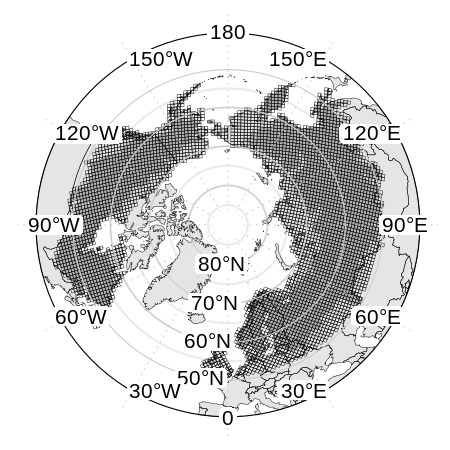

In [51]:
options(repr.plot.width = 3, repr.plot.height = 3, repr.plot.res = 150)

m_boreal_tiles = DO_MAP_BOREAL_SP(MAP_EXTENT=ext,  
                     BOREAL_SHP_FN = wwf_circ_dis_fn,
                     LAYER_LIST = list(geom_polygon(data = boreal_tiles_gcs %>% dplyr::filter(tile_num %in% boreal_tile_num_DAAC_list), 
                                                    aes(x = long, y = lat, group = group), size=0.1, fill=NA, color='black')) #, fill=NA
                    ) + 
    theme(legend.text=element_text(size=rel(0.5))) #+
    #scale_color_brewer(palette = 'Set2') +
    #scale_fill_viridis_d() +
    #guides(fill=guide_legend(title="Tile groups", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"), nrow=2))
m_boreal_tiles

## Export figure: Boreal tiles

In [50]:
DATA_NAME_STEM = "boreal_tiles"
EXPORT_TIME_STR = format(Sys.time(), "_%Y%m%d")

for(OUT_TYPE in c('png', 'pdf')){
    map_fn = path('/home/pmontesa/pmontesa/userfs02/projects/above_icesat2/boreal_tiles', paste0("map_",DATA_NAME_STEM, EXPORT_TIME_STR,".", OUT_TYPE))
    print(map_fn)
    ggsave(plot = m_boreal_tiles,
           file = map_fn,
           device = OUT_TYPE, dpi = 300, width = 10, height = 8)
}

/home/pmontesa/pmontesa/userfs02/projects/above_icesat2/boreal_tiles/map_boreal_tiles_20230705.png
/home/pmontesa/pmontesa/userfs02/projects/above_icesat2/boreal_tiles/map_boreal_tiles_20230705.pdf


OGR data source with driver: ESRI Shapefile 
Source: "/projects/my-public-bucket/databank/arc/wwf_circumboreal_Dissolve.shp", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields
Integer64 fields read as strings:  OBJECTID 


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



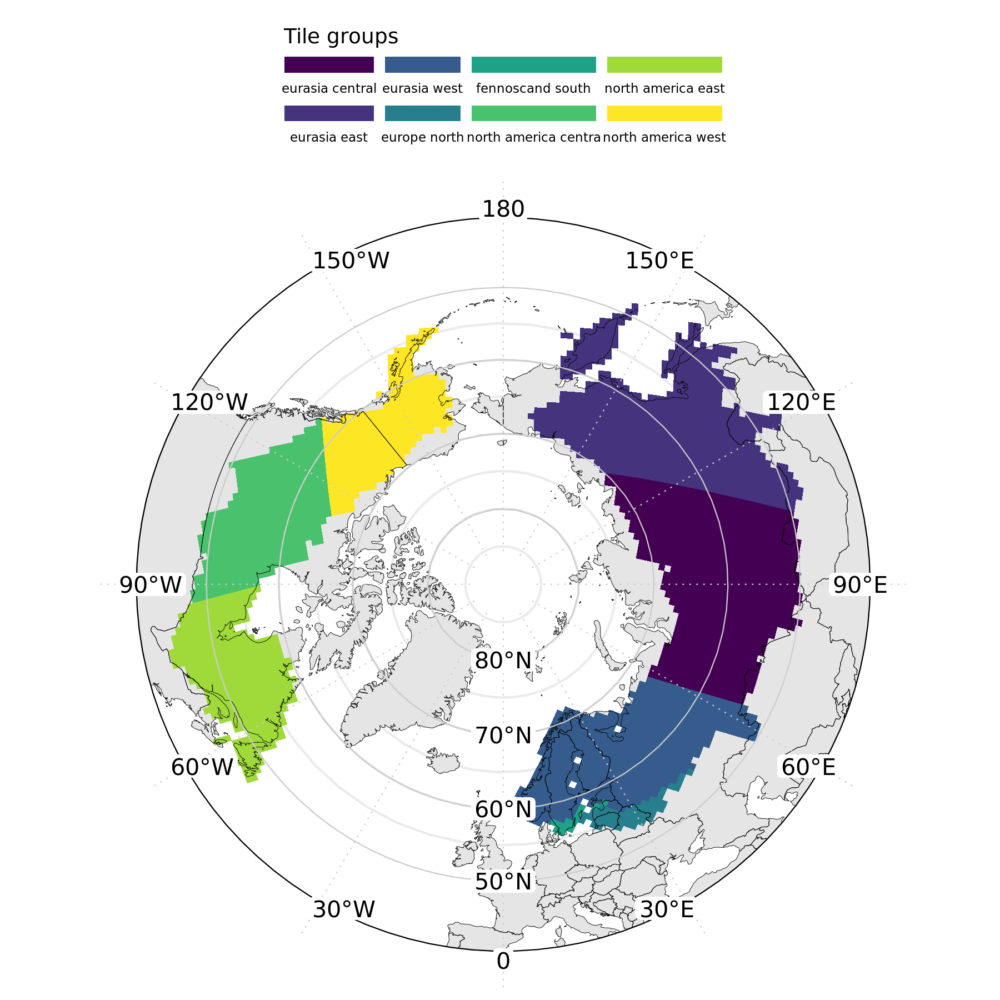

In [16]:
options(repr.plot.width = 6, repr.plot.height = 6, repr.plot.res = 300)

m_groups = DO_MAP_BOREAL_SP(MAP_EXTENT=ext,  
                     BOREAL_SHP_FN = wwf_circ_dis_fn,
                     LAYER_LIST = list(geom_polygon(data = boreal_tiles_gcs %>% dplyr::filter(tile_num %in% boreal_tile_num_list), 
                                                    aes(x = long, y = lat, group = group, fill=tile_group), size=0.1)) #, fill=NA
                    ) + 
    theme(legend.text=element_text(size=rel(0.5))) +
    #scale_color_brewer(palette = 'Set2') +
    scale_fill_viridis_d() +
    guides(fill=guide_legend(title="Tile groups", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"), nrow=2))
m_groups
    


### Read in boreal AGB training (field) plots

In [43]:
boreal_training = as_Spatial( st_as_sf(read.csv("/projects/shared-buckets/minord/data/above/boreal_plot_density.csv"), coords = c('longitude', 'latitude') , crs = "+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs"))%>% 
            as.data.frame()
names(boreal_training)[1] = "value"
names(boreal_training)[length(names(boreal_training))-1] = "x"
names(boreal_training)[length(names(boreal_training))] = "y"

geom_field_list = list(
        geom_point(data = boreal_training, aes(x = x, y = y, size=value), shape=21, color='black'),
        scale_radius(),
        guides(size=guide_legend(title="# field plots", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"), ncol=4))
)

## Map MODIS PFT and training plots
This is the MODIS Type 1 PFT, which I think we decided to use because it was already included in ATL08.  
For this figure, I made a coarsened version that sampled the PFT every 0.1 degrees: shared-buckets/minord/data/above/modis_type1_pft_coarsened.csv



In [14]:
modis_pft = sample_frac(read.csv("/projects/shared-buckets/minord/data/above/modis_type1_pft_coarsened.csv"), 0.5)
levels(factor(modis_pft$pft_modis))

modis_pft_sf = st_as_sf(modis_pft, coords = c('longitude', 'latitude') , crs = "+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs")# %>% st_transform(crs_canalb)

[1] "Closed Shrubland"           "Deciduous Broadleaf trees" 
 [3] "Deciduous Needleleaf trees" "Evergreen Broadleaf trees" 
 [5] "Evergreen Needleleaf trees" "Grasslands"                
 [7] "Mixed forests"              "Open Shrublands"           
 [9] "Permanent wetlands"         "Savannas"                  
[11] "Woody savannas"

In [15]:
modis_pft_geo_p =  as_Spatial( 
                    st_intersection(modis_pft_sf, st_as_sf(boreal) %>% select(REALM)) #%>% 
                    #st_transform(crs = crs_gcs)
                    )%>% 
            as.data.frame()
names(modis_pft_geo_p)[1] = "value"
names(modis_pft_geo_p)[length(names(modis_pft_geo_p))-1] = "x"
names(modis_pft_geo_p)[length(names(modis_pft_geo_p))] = "y"
class(modis_pft_geo_p)

Warning message:
“attribute variables are assumed to be spatially constant throughout all geometries”


[1] "data.frame"

In [16]:
modis_pft_geo_p$pft_modis = factor(modis_pft_geo_p$pft_modis)

In [17]:
levels(factor(modis_pft_geo_p$pft_modis) )

[1] "Closed Shrubland"           "Deciduous Broadleaf trees" 
 [3] "Deciduous Needleleaf trees" "Evergreen Broadleaf trees" 
 [5] "Evergreen Needleleaf trees" "Grasslands"                
 [7] "Mixed forests"              "Open Shrublands"           
 [9] "Permanent wetlands"         "Savannas"                  
[11] "Woody savannas"

In [18]:

#modis_pft_geo_p$pft_modis = factor(modis_pft_geo_p$pft_modis, levels = gsub(" trees", " ", levels(factor(modis_pft_geo_p$pft_modis) )))


In [19]:
levels(modis_pft_geo_p$pft_modis)

[1] "Closed Shrubland"           "Deciduous Broadleaf trees" 
 [3] "Deciduous Needleleaf trees" "Evergreen Broadleaf trees" 
 [5] "Evergreen Needleleaf trees" "Grasslands"                
 [7] "Mixed forests"              "Open Shrublands"           
 [9] "Permanent wetlands"         "Savannas"                  
[11] "Woody savannas"

In [20]:
head(modis_pft_geo_p %>% drop_na())

,value,date,pft_modis,REALM,x,y
,<int>,<chr>,<fct>,<chr>,<dbl>,<dbl>
1,1,2017-01-01,Evergreen Needleleaf trees,NA,-126.8,60.9
2,1,2017-01-01,Evergreen Needleleaf trees,NA,-94.5,52.3
3,1,2017-01-01,Evergreen Needleleaf trees,NA,-72.3,52.0
4,1,2017-01-01,Evergreen Needleleaf trees,NA,-62.0,56.3
5,1,2017-01-01,Closed Shrubland,NA,-130.1,61.7
6,1,2017-01-01,Mixed forests,NA,-133.8,64.9


In [21]:
dim(modis_pft_geo_p  %>% drop_na())

[1] 147610      6

In [22]:
map_extent = extent(-180, 180, 45, 90)
min_lat = map_extent[3]

year_agb = '2020'
VERSION = 'v2.1'
dim(modis_pft_geo_p)

PFT_COLOR_DICT = c(
                'Evergreen Broadleaf trees' = '#5aae61',
                'Deciduous Broadleaf trees' = '#5aae61',
                'Deciduous Needleleaf trees'= '#a6dba0',
                'Evergreen Needleleaf trees' ='#1b7837',#'#542608',
                'Grass/Shrub/Wet/Savanna' =   '#e6ab02',
                'Mixed forests' =             '#718a6e'
    )

#['Deciduous broadleaf trees' = '#1b9e77','#d95f02','#7570b3','#e7298a','#66a61e','#e6ab02','#a6761d']

# PFT_COLOR_DICT = c('Closed Shrubland'='#ebd775', 'Open Shrublands'='#ebd775', 'Grasslands'='#ebd775', 
# 'Savannas'='#ebd775', 'Evergreen Needleleaf trees'='#542608', 'Deciduous Broadleaf trees'='#34a327',
# 'Evergreen Broadleaf trees'='#91f783', 'Woody savannas'='#ebd775', 'Permanent wetlands'='#ebd775', 
#                    'Mixed forests'='#718a6e', 'Deciduous Needleleaf trees'='#542608', 'NA'='#c3c5c9')

# Case needs a character col
modis_pft_geo_p$pft_modis = as.character(modis_pft_geo_p$pft_modis)

modis_pft_geo_p = modis_pft_geo_p %>%
    dplyr::mutate(pft_modis_adj = case_when(pft_modis == 'Closed Shrubland' ~   'Grass/Shrub/Wet/Savanna', 
                                            pft_modis == 'Open Shrubland' ~     'Grass/Shrub/Wet/Savanna', 
                                            pft_modis == 'Grasslands' ~         'Grass/Shrub/Wet/Savanna', 
                                            pft_modis == 'Woody savannas' ~     'Grass/Shrub/Wet/Savanna', 
                                            pft_modis == 'Permanent wetlands' ~ 'Grass/Shrub/Wet/Savanna', 
                                                   TRUE ~ pft_modis))
# Put to factor
modis_pft_geo_p$pft_modis_adj = factor(modis_pft_geo_p$pft_modis_adj)

theme_and_labs = list(
    theme_classic(),
    labs(#title="Circumpolar boreal plant functional type",
        #subtitle = paste0("c. ",year_agb," 30 m resolution, provisional","\nData sources: ICESat-2, Landsat-8, Copernicus DEM"),
         #caption = paste0("# obs: ", NUM_ATL08_OBS, "\n# obs (night): ", NUM_ATL08_NIGHT_OBS)
         #caption = 'Arctic Boreal Vulnerability Experiment (ABoVE)\nNASA Goddard Space Flight Center\nU. of Maryland Dept. Geographical Sciences'
    )
)



[1] 152859      6

In [38]:
pft_layer_list = list( 
    geom_point(data = sample_frac(modis_pft_geo_p, 1) %>% 
               dplyr::filter(y > min_lat)
               
               , aes(x = x, y = y, color = pft_modis_adj), size = 0.1, alpha = 0.25),
    #scale_color_gradientn(limits = c(0,MAX_AGB), breaks = seq(0,MAX_AGB,50), colours = viridis(10), name = expression(Mg~ha^{-1})),
    theme_and_labs,
    #scale_color_viridis_d(option = "magma",
    #                       guide = guide_legend(override.aes = list(size = 3) ) )
    scale_color_manual(values = PFT_COLOR_DICT)
    
    #theme(legend.text=element_text(size=rel(0.25)))
    #guides(color=guide_legend(title="Boreal plant functional type", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.5, "cm"), nrow=1))+
    
)

m_pft = DO_MAP_BOREAL_SP(MAP_EXTENT=map_extent, boreal_shp_fn = boreal_shp_fn, LAYER_LIST = pft_layer_list) +
    scale_color_manual(values = PFT_COLOR_DICT) +
    guides(color = guide_legend(
        title="Boreal plant\nfunctional type", title.position = "top", label.position = "right", 
        #legend.text=element_text(size=rel(0.0025)),
        override.aes = list(size = 2, alpha=1) ,
        keywidth = unit(.5, "cm"), keyheight = unit(.5, "cm"), nrow=6
    ) )+
    theme(legend.text=element_text(size=rel(0.5)), legend.position = 'right')


OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



Scale for 'size' is already present. Adding another scale for 'size', which
will replace the existing scale.



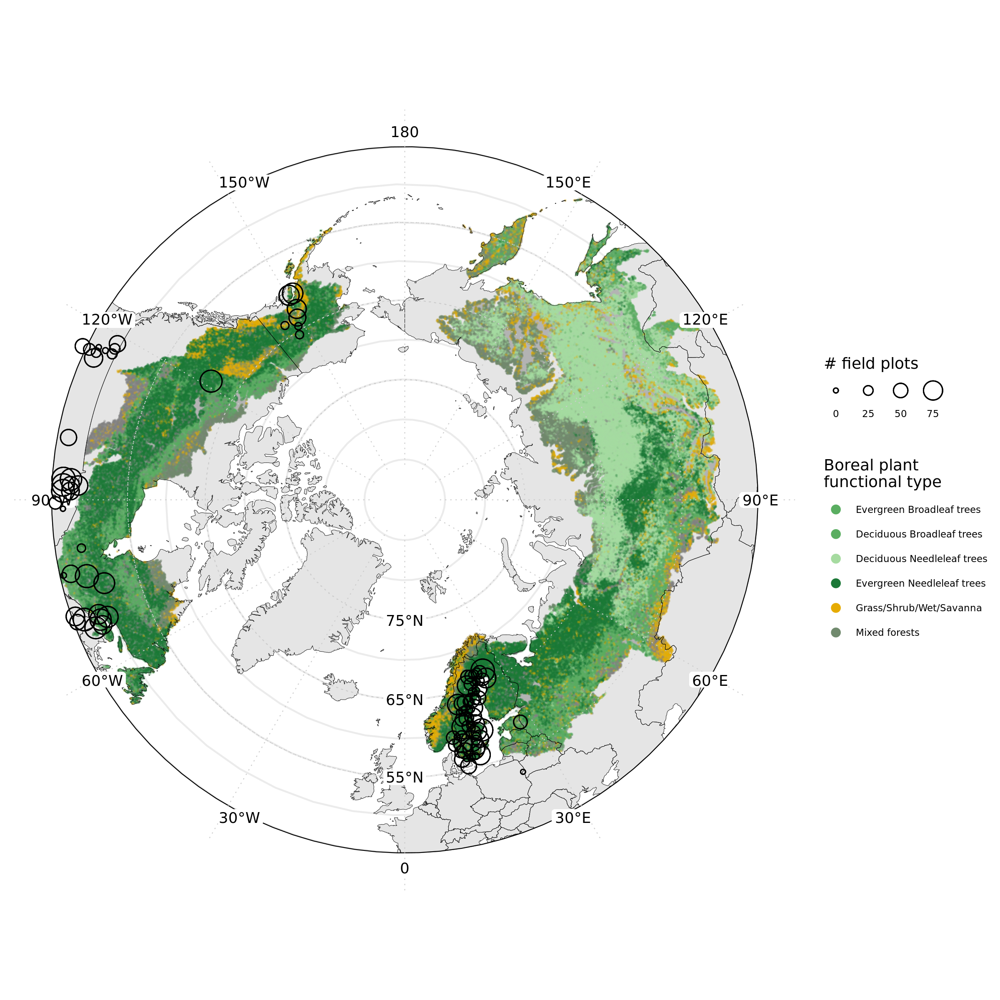

In [41]:
options(repr.plot.width = 8, repr.plot.height = 8, repr.plot.res = 300)

# Adding the boreal training field plots
m_pft = m_pft + geom_field_list
m_pft

## Export figure: MODIS PFT & training plots

In [42]:
DATA_NAME_STEM = "MODISPFT_trainingplots"
EXPORT_TIME_STR = format(Sys.time(), "_%Y%m%d")

for(OUT_TYPE in c('png', 'pdf')){
    map_fn = path(OUT_FIGURE_DIR, paste0("map_",DATA_NAME_STEM, EXPORT_TIME_STR,".", OUT_TYPE))
    print(map_fn)
    ggsave(plot = m_pft,
           file = map_fn,
           device = OUT_TYPE, dpi = 300, width = 10, height = 8)
}

/projects/my-public-bucket/boreal_polar_map/paper_figs/map_MODISPFT_trainingplots_20230217.png
/projects/my-public-bucket/boreal_polar_map/paper_figs/map_MODISPFT_trainingplots_20230217.pdf


## Map HLS compositing params

In [322]:
# #hls_params = read.csv("/projects/shared-buckets/nathanmthomas/DPS_tile_lists/HLS_test_redo/spring2022/HLS_input_params.csv")
# hls_params = read.csv("/projects/shared-buckets/nathanmthomas/DPS_tile_lists/HLS/fall2022/HLS_stack_2022_v2/HLS_input_params.csv")

# This is the final list of HLS tiles that include the fixed (45) tiles
Sys.setenv("AWS_DEFAULT_REGION" = "us-west-2") 
# Read rom s3
hls_params <- aws.s3::s3read_using(read.csv, object = hls_params_fn)

boreal_tiles_gcs_HLS = boreal_tiles_gcs %>% 
    dplyr::mutate(tile_num = as.numeric(tile_num)) %>% 
    dplyr::left_join(hls_params, by = c('tile_num' = 'tile_num')) %>%
    unite(HLS_run_name, c("max_cloud","start_month_day","end_month_day"),sep = "\n", remove = FALSE)

In [323]:
head(boreal_tiles_gcs_HLS %>% filter(tile_num == '1000'))

,long,lat,order,hole,piece,id,group,tile_num,tile_version,tile_group,⋯,X,HLS_run_name,max_cloud,start_month_day,end_month_day,start_year,end_year,json_path,num_scenes,run_type
,<dbl>,<dbl>,<int>,<lgl>,<fct>,<chr>,<fct>,<dbl>,<chr>,<chr>,⋯,<int>,<chr>,<int>,<chr>,<chr>,<int>,<int>,<chr>,<int>,<chr>
1,71.15990,43.90672,1,FALSE,1,1000,1000.1,1000,version 1,eurasia central,⋯,0,25 06-15 09-01,25,06-15,09-01,2019,2021,s3://maap-ops-workspace/nathanmthomas/dps_output/do_HLS_stack_3-1-2_ubuntu/HLS_stack_2022_v2/2022/10/18/13/15/48/506890/HLS_1000_06-15_09-01_2019_2021.tif,80,25_06-15_09-01_2019_2021
2,72.26095,43.94068,2,FALSE,1,1000,1000.1,1000,version 1,eurasia central,⋯,0,25 06-15 09-01,25,06-15,09-01,2019,2021,s3://maap-ops-workspace/nathanmthomas/dps_output/do_HLS_stack_3-1-2_ubuntu/HLS_stack_2022_v2/2022/10/18/13/15/48/506890/HLS_1000_06-15_09-01_2019_2021.tif,80,25_06-15_09-01_2019_2021
3,72.29679,43.11628,3,FALSE,1,1000,1000.1,1000,version 1,eurasia central,⋯,0,25 06-15 09-01,25,06-15,09-01,2019,2021,s3://maap-ops-workspace/nathanmthomas/dps_output/do_HLS_stack_3-1-2_ubuntu/HLS_stack_2022_v2/2022/10/18/13/15/48/506890/HLS_1000_06-15_09-01_2019_2021.tif,80,25_06-15_09-01_2019_2021
4,71.21346,43.08277,4,FALSE,1,1000,1000.1,1000,version 1,eurasia central,⋯,0,25 06-15 09-01,25,06-15,09-01,2019,2021,s3://maap-ops-workspace/nathanmthomas/dps_output/do_HLS_stack_3-1-2_ubuntu/HLS_stack_2022_v2/2022/10/18/13/15/48/506890/HLS_1000_06-15_09-01_2019_2021.tif,80,25_06-15_09-01_2019_2021
5,71.15990,43.90672,5,FALSE,1,1000,1000.1,1000,version 1,eurasia central,⋯,0,25 06-15 09-01,25,06-15,09-01,2019,2021,s3://maap-ops-workspace/nathanmthomas/dps_output/do_HLS_stack_3-1-2_ubuntu/HLS_stack_2022_v2/2022/10/18/13/15/48/506890/HLS_1000_06-15_09-01_2019_2021.tif,80,25_06-15_09-01_2019_2021


In [324]:
options(repr.plot.width = 6, repr.plot.height = 6, repr.plot.res = 300)
# Show map of HLS compositing params

m_hls_runname = DO_MAP_BOREAL_SP(MAP_EXTENT=ext,  
                     boreal_shp_fn = boreal_shp_fn,
                     LAYER_LIST = list(geom_polygon(data = boreal_tiles_gcs_HLS %>% dplyr::filter(tile_num %in% boreal_tile_num_list), 
                                                    aes(x = long, y = lat, group = group, fill=HLS_run_name), size=0.1)
                                      
                                      )
                    ) + 
    theme(legend.text=element_text(size=rel(0.75))) +
    guides(fill=guide_legend(title="Multispectral composite type", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"), nrow=1))+
    #scale_fill_manual(values= c(wes_palette("Zissou1", n = 5), wes_palette("Darjeeling1", n = 5))) 
    scale_fill_brewer(palette='Paired')


m_hls_maxcloud = DO_MAP_BOREAL_SP(MAP_EXTENT=ext,  
                     boreal_shp_fn = boreal_shp_fn,
                     LAYER_LIST = list(geom_polygon(data = boreal_tiles_gcs_HLS %>% dplyr::filter(tile_num %in% boreal_tile_num_list), 
                                                    aes(x = long, y = lat, group = group, fill=max_cloud), size=0.1))
                    ) +
    theme(legend.text=element_text(size=rel(0.75))) +
    scale_fill_viridis(option='plasma', direction=-1) +
    guides(fill=guide_colourbar(title="Multispectral composite max cloudcover (%)", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm")))


OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



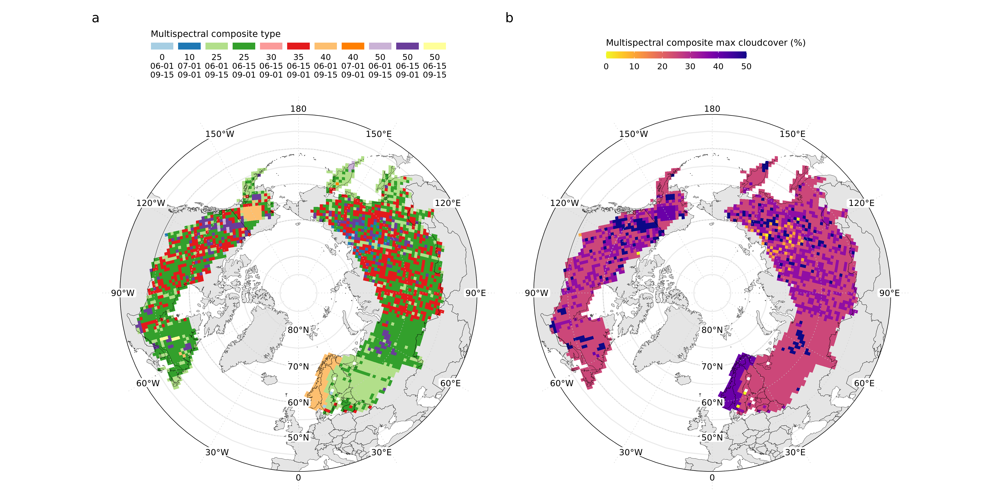

In [325]:
options(repr.plot.height = 7, repr.plot.width = 14, warn=-1)

layout = "
AB
"

m_hls_runname + m_hls_maxcloud +
    plot_layout(design = layout) +
    plot_annotation(tag_levels = 'a') #+ theme(plot.tag = element_text(size = 26))



`summarise()` has grouped output by 'tile_num', 'HLS_run_name'. You can override using the `.groups` argument.



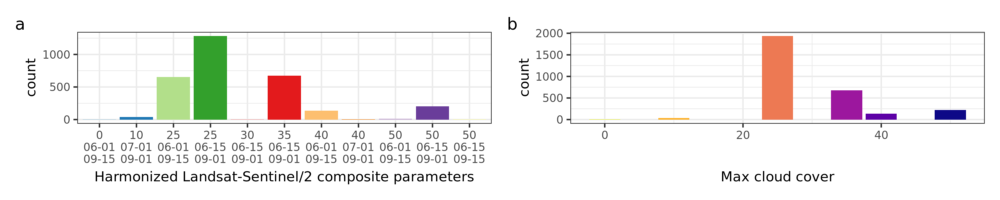

In [102]:
options(repr.plot.height = 2, repr.plot.width = 10, warn=-1)

df = boreal_tiles_gcs_HLS %>% 
    dplyr::filter(tile_num %in% boreal_tile_num_list) %>%
    dplyr::group_by(tile_num, HLS_run_name, max_cloud) %>%
    dplyr::summarize(tile_num = mean(tile_num)) # Need to summarize like this to get back to 1 row per tile_num

hist_params = df %>% ggplot() + 
    geom_histogram(aes(x=HLS_run_name, fill=HLS_run_name), stat="count", show.legend=FALSE)+
    scale_fill_brewer(palette='Paired') +
    theme_bw() +
    theme(text=element_text(size=10)) +
    labs(x='Harmonized Landsat-Sentinel/2 composite parameters')

hist_clouds = df %>% ggplot() + 
    geom_histogram(aes(x=max_cloud, fill=factor(max_cloud)), stat="count", show.legend=FALSE)+
    scale_fill_viridis_d(option='plasma', direction=-1) +
    theme_bw() +
    theme(text=element_text(size=10)) +
    labs(x='Max cloud cover')

layout = "
AB
"

hist_params + hist_clouds +
    plot_layout(design = layout) +
    plot_annotation(tag_levels = 'a') #+ theme(plot.tag = element_text(size = 26))

# AGB RF Model Stats
Loop through the tindex to get the `*stats.Rds` file for each AGB COG and build a data frame of RF model stats per tile

In [11]:
Sys.setenv("AWS_DEFAULT_REGION" = "us-west-2") 

# Read the tindex from s3
AGB_tindex_master <- aws.s3::s3read_using(read.csv, object = AGB_tindex_master_fn)

# for each file, loop through to get the total AGB csv
list_s3_path <- AGB_tindex_master$s3_path

borealstats_df_list = list()

for(fn in list_s3_path){
    
    df = setNames(data.frame(matrix(ncol = 3)),  c('tile_num', 'r2', 'rmse'))
    stats = aws.s3::s3read_using(readRDS, object = gsub('.tif', '_stats.Rds' , fn))
    fn_base = unlist(str_split(basename(fn),'.tif'))[1]
    fn_parts_list = unlist(str_split(fn_base, '_'))
    tile_num = fn_parts_list[length(fn_parts_list)]
    df$tile_num = as.numeric(tile_num)
    df$r2 = stats[[1]]
    df$rmse = stats[[2]]
    
    borealstats_df_list[[tile_num]] = df
}
borealstats_df = do.call('rbind', borealstats_df_list)
head(borealstats_df)

,tile_num,r2,rmse
,<dbl>,<dbl>,<dbl>
1326,1326,0.313255188,13.361310
3402,3402,0.004414789,6.149694
3417,3417,0.371394798,15.712186
3215,3215,0.080286302,7.486559
3035,3035,0.464018561,14.660439
2782,2782,0.305795264,9.551947


In [12]:
dim(borealstats_df)

[1] 4925    3

### Join AGB RF stats to boreal tiles

In [13]:
# stats from SPRING 2022 version
#borealstats_df = read.csv("/projects/shared-buckets/lduncanson/borealstats.csv")

boreal_tiles_gcs_stats = boreal_tiles_gcs %>% 
                            dplyr::mutate(tile_num = as.numeric(tile_num),
                                         map_version = AGB_tindex_master_fn) %>% 
                            dplyr::left_join(borealstats_df, by = c('tile_num' = 'tile_num')) 
head(boreal_tiles_gcs_stats %>% drop_na())

,long,lat,order,hole,piece,id,group,tile_num,tile_version,tile_group,map_version,r2,rmse
,<dbl>,<dbl>,<int>,<lgl>,<fct>,<chr>,<fct>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>
1,6.672362,56.91323,1,FALSE,1,4,4.1,4,version 1,eurasia west,s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/c2020/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv,0.2048394,28.09192
2,7.483985,57.58611,2,FALSE,1,4,4.1,4,version 1,eurasia west,s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/c2020/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv,0.2048394,28.09192
3,8.748943,57.14697,3,FALSE,1,4,4.1,4,version 1,eurasia west,s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/c2020/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv,0.2048394,28.09192
4,7.923729,56.48187,4,FALSE,1,4,4.1,4,version 1,eurasia west,s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/c2020/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv,0.2048394,28.09192
5,6.672362,56.91323,5,FALSE,1,4,4.1,4,version 1,eurasia west,s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/c2020/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv,0.2048394,28.09192
6,8.748943,57.14697,1,FALSE,1,9,9.1,9,version 1,eurasia west,s3://maap-ops-workspace/shared/nathanmthomas/DPS_tile_lists/AGB/c2020/map_boreal_2022_rh_noground_v4/AGB_tindex_master.csv,0.3272887,29.15187


In [48]:
options(repr.plot.width = 6, repr.plot.height = 6, repr.plot.res = 300)
# Show map of HLS compositing params

m_rmse = DO_MAP_BOREAL_SP(MAP_EXTENT=ext,  
                     boreal_shp_fn = boreal_shp_fn,
                     LAYER_LIST = list(geom_polygon(data = boreal_tiles_gcs_stats %>% dplyr::filter(tile_num %in% boreal_tile_num_list), 
                                                    aes(x = long, y = lat, group = group, fill=rmse), size=0.1)
                                      )
                    ) + 
    theme(legend.text=element_text(size=rel(0.75))) +
    guides(fill=guide_colourbar(title=expression("Model RMSE ["~Mg~ha^{-1}~"]"), title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"), nrow=1))+
    scale_fill_viridis(option = 'rocket')

m_r2 = DO_MAP_BOREAL_SP(MAP_EXTENT=ext,  
                     boreal_shp_fn = boreal_shp_fn,
                     LAYER_LIST = list(geom_polygon(data = boreal_tiles_gcs_stats %>% dplyr::filter(tile_num %in% boreal_tile_num_list), 
                                                    aes(x = long, y = lat, group = group, fill=r2), size=0.1)
                                      )
                    ) + 
    theme(legend.text=element_text(size=rel(0.75))) +
    guides(fill=guide_colourbar(title=expression("Model "~R^{2}), title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"), nrow=1))+
    scale_fill_viridis(option = 'turbo')


OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



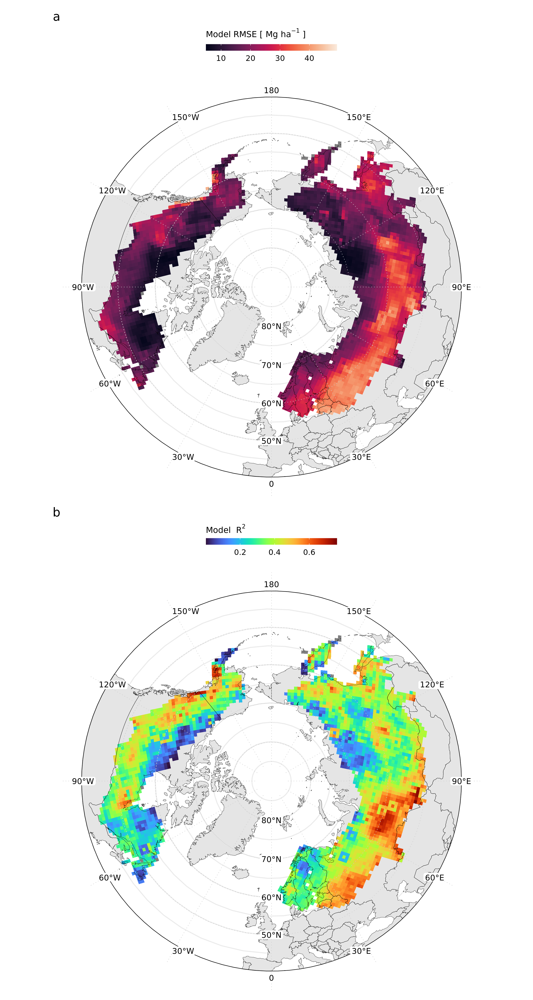

In [59]:
options(repr.plot.width =8, repr.plot.height =15, repr.plot.res = 300)

p_boreal_model_stats = (m_rmse / m_r2) +
          plot_annotation(tag_levels = "a")  

p_boreal_model_stats

## Export figure: model stats

In [60]:
DATA_NAME_STEM = "boreal_model_stats"
EXPORT_TIME_STR = format(Sys.time(), "_%Y%m%d")

for(OUT_TYPE in c('png', 'pdf')){
    map_fn = path(OUT_FIGURE_DIR, paste0("map_",DATA_NAME_STEM,"_", var_ht, EXPORT_TIME_STR,".", OUT_TYPE))
    print(map_fn)
    ggsave(plot = p_boreal_model_stats,
           file = map_fn,
           device = OUT_TYPE, dpi = 300, width = 8, height = 15)
}

ERROR: Error in paste0("map_", DATA_NAME_STEM, "_", var_ht, EXPORT_TIME_STR, : object 'var_ht' not found


# ICESat-2 ATL08 30m obs

In [17]:
Sys.setenv("AWS_DEFAULT_REGION" = "us-west-2") 
# # SPRING 2022 version
# ATL08_filt = read.csv("/projects/shared-buckets/nathanmthomas/DPS_tile_lists/07/ATL08_filt_tindex_master.csv")
# # FALL 2022 version using atl03 rh metrics (does not include ground photons in calc of RH metrics)
# Atl08_filt = read.csv("/projects/shared-buckets/lduncanson/DPS_tile_lists/fall2022/with_atl03_rh/ATL08_filt_tindex_master.csv")

# FALL 2022 version used for final map
#Atl08_filt = read.csv("/projects/shared-buckets/lduncanson/DPS_tile_lists/fall2022/ATL08_filt_tindex_master.csv")
# Read the tindex from s3
Atl08_filt <- aws.s3::s3read_using(read.csv, object = ATL08_filt_tindex_master_fn)

boreal_tiles_gcs_ATL08obs = boreal_tiles_gcs %>% 
    dplyr::mutate(tile_num = as.numeric(tile_num)) %>% 
    dplyr::left_join(Atl08_filt, by = c('tile_num' = 'tile_num'))
head(boreal_tiles_gcs_ATL08obs)

,long,lat,order,hole,piece,id,group,tile_num,tile_version,tile_group,map_version,Unnamed..0,s3_path,local_path,file,n_obs
,<dbl>,<dbl>,<int>,<lgl>,<fct>,<chr>,<fct>,<dbl>,<chr>,<chr>,<chr>,<int>,<chr>,<chr>,<chr>,<int>
1,4.624619,56.64562,1,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA,NA,NA,NA,NA
2,5.390977,57.33162,2,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA,NA,NA,NA,NA
3,6.672362,56.91323,3,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA,NA,NA,NA,NA
4,5.890771,56.23471,4,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA,NA,NA,NA,NA
5,4.624619,56.64562,5,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA,NA,NA,NA,NA
6,3.329813,57.04317,1,FALSE,1,2,2.1,2,version 1,eurasia west,NA,NA,NA,NA,NA,NA


OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



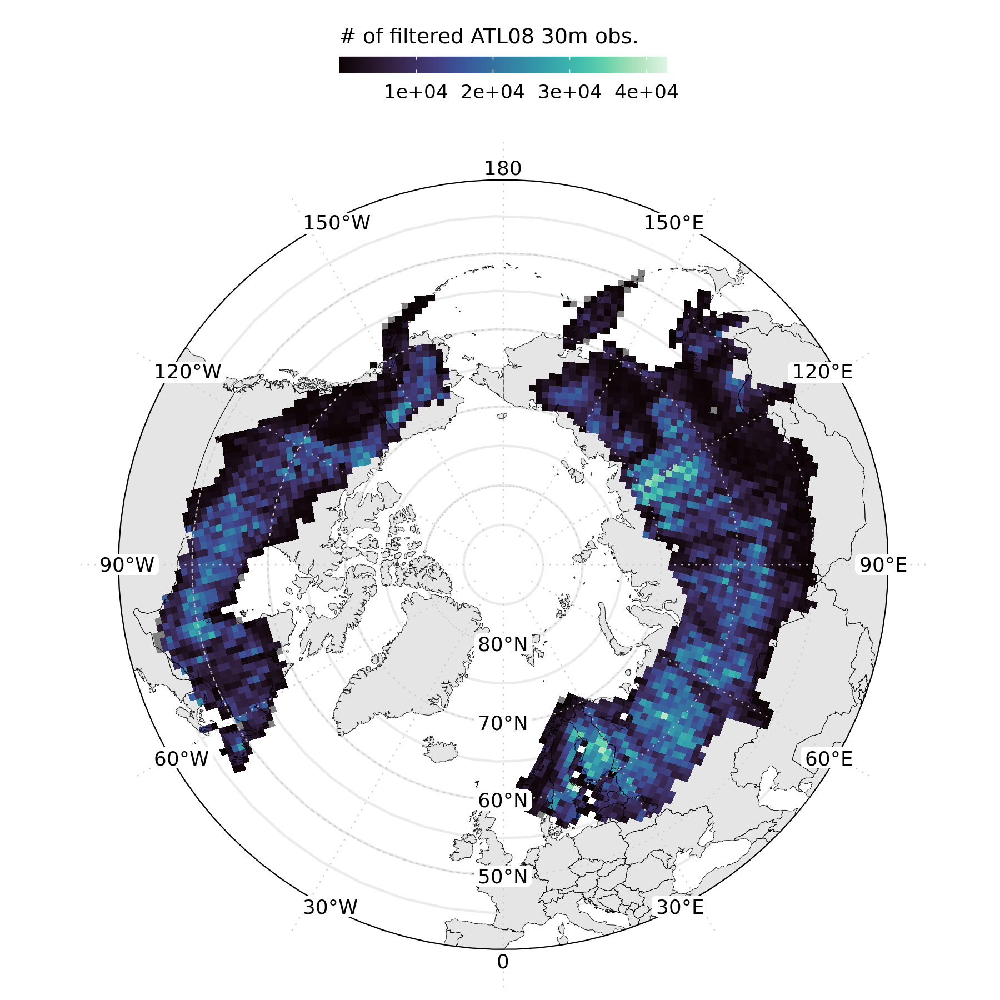

In [378]:
options(repr.plot.width = 6, repr.plot.height = 6, repr.plot.res = 300)
# Show map of HLS compositing params

m_ATL08obs_tile = DO_MAP_BOREAL_SP(MAP_EXTENT=ext,  
                     boreal_shp_fn = boreal_shp_fn,
                     LAYER_LIST = list(geom_polygon(data = boreal_tiles_gcs_ATL08obs %>% dplyr::filter(tile_num %in% boreal_tile_num_list), 
                                                    aes(x = long, y = lat, group = group, fill=n_obs), size=0.1)
                                      )
                    ) + 
    theme(legend.text=element_text(size=rel(0.75))) +
    guides(fill=guide_colourbar(title="# of filtered ATL08 30m obs.", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm")))+
    scale_fill_viridis(option = 'mako', labels = scientific)

m_ATL08obs_tile

## Export figure: ATL08 obs count

In [379]:
DATA_NAME_STEM = "ATL08_obs_tile"
EXPORT_TIME_STR = format(Sys.time(), "_%Y%m%d")

for(OUT_TYPE in c('png', 'pdf')){
    map_fn = path(OUT_FIGURE_DIR, paste0("map_",DATA_NAME_STEM,"_", var_ht, EXPORT_TIME_STR,".", OUT_TYPE))
    print(map_fn)
    ggsave(plot = m_ATL08obs_tile,
           file = map_fn,
           device = OUT_TYPE, dpi = 300, width = 6, height = 6)
}

/projects/my-public-bucket/boreal_polar_map/paper_figs/map_ATL08_obs_tile_h_can_20230207.png
/projects/my-public-bucket/boreal_polar_map/paper_figs/map_ATL08_obs_tile_h_can_20230207.pdf


#### Read ATL08, filter ATL08 file list CSV by boreal tile nums

In [15]:
print(dim(Atl08_filt))
files_boreal = Atl08_filt %>% dplyr::filter(tile_num %in% boreal_tile_num_list)
print(dim(files_boreal))
head(files_boreal)

[1] 4880    6
[1] 2991    6


,Unnamed..0,s3_path,local_path,file,tile_num,n_obs
,<int>,<chr>,<chr>,<chr>,<int>,<int>
1,34,s3://maap-ops-workspace/lduncanson/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/12/01/13/59/41/965091/atl08_005_30m_filt_topo_landsat_20221201_1920.csv,/projects/my-private-bucket/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/12/01/13/59/41/965091/atl08_005_30m_filt_topo_landsat_20221201_1920.csv,atl08_005_30m_filt_topo_landsat_20221201_1920.csv,1920,739
2,22,s3://maap-ops-workspace/lduncanson/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/12/01/13/46/39/030721/atl08_005_30m_filt_topo_landsat_20221201_3456.csv,/projects/my-private-bucket/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/12/01/13/46/39/030721/atl08_005_30m_filt_topo_landsat_20221201_3456.csv,atl08_005_30m_filt_topo_landsat_20221201_3456.csv,3456,9314
3,18,s3://maap-ops-workspace/lduncanson/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/12/01/13/45/56/388940/atl08_005_30m_filt_topo_landsat_20221201_3382.csv,/projects/my-private-bucket/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/12/01/13/45/56/388940/atl08_005_30m_filt_topo_landsat_20221201_3382.csv,atl08_005_30m_filt_topo_landsat_20221201_3382.csv,3382,1221
4,9740,s3://maap-ops-workspace/lduncanson/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/11/30/23/59/49/099732/atl08_005_30m_filt_topo_landsat_20221130_3109.csv,/projects/my-private-bucket/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/11/30/23/59/49/099732/atl08_005_30m_filt_topo_landsat_20221130_3109.csv,atl08_005_30m_filt_topo_landsat_20221130_3109.csv,3109,4608
5,9734,s3://maap-ops-workspace/lduncanson/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/11/30/23/58/45/703343/atl08_005_30m_filt_topo_landsat_20221130_27382.csv,/projects/my-private-bucket/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/11/30/23/58/45/703343/atl08_005_30m_filt_topo_landsat_20221130_27382.csv,atl08_005_30m_filt_topo_landsat_20221130_27382.csv,27382,7135
6,9722,s3://maap-ops-workspace/lduncanson/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/11/30/23/58/23/178851/atl08_005_30m_filt_topo_landsat_20221130_27646.csv,/projects/my-private-bucket/dps_output/run_tile_atl08_ubuntu/tile_atl08/2022/11/30/23/58/23/178851/atl08_005_30m_filt_topo_landsat_20221130_27646.csv,atl08_005_30m_filt_topo_landsat_20221130_27646.csv,27646,14784


## Read filtered ATL08 obs
#### Read in our set of ATL08 filt CSV tiles (where the tiles have been clipped to the boreal domain), and clip the observations to the boreal domain

In [ ]:
atl08 = do.call(rbind, lapply(
    files_boreal$s3_path, 
    #head(files_boreal, 100)$s3_path) #<-- for testing
    function(x) aws.s3::s3read_using(fread, object = x)
    ))
print(paste0('Total filtered ATL08 obs for ', dim(files_boreal)[1],' tiles of boreal domain: ', dim(atl08)[1]))
head(atl08)

In [ ]:
# atl08_sf = st_intersection(st_as_sf(
#                                 sample_frac(
#                                             data.frame(atl08),
#                                             0.01
#                                             ),
#                                 coords = c('lon', 'lat') , 
#                                 crs = "+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs"), 
#                         #boreal # intersect ATL08 with boreal extent
#                         boreal_tiles_clip # intersect ATL08 with boreal tiles extent
#                                 )
# atl08_sf = as(cbind(atl08_sf, st_coordinates(atl08_sf)), 'Spatial') 

### this takes a long time; may crash the workspace
```good luck```

In [ ]:
atl08 = st_intersection(st_as_sf(
                                sample_frac(
                                            #do.call(rbind, lapply(files_boreal$s3_path, function(x) fread(x, stringsAsFactors = TRUE))), 
                                            do.call(rbind, lapply(files_boreal$s3_path, function(x) aws.s3::s3read_using(fread, object = x))),
                                            0.01
                                            ),
                                coords = c('lon', 'lat') , 
                                crs = "+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs"), 
                        #boreal # intersect ATL08 with boreal extent
                        boreal_tiles_clip # intersect ATL08 with boreal tiles extent
                                )
atl08 = as(cbind(atl08, st_coordinates(atl08)), 'Spatial')                           

In [ ]:
dim(atl08_sf)

## Plot filtered ATL08 30m obs across boreal tiles domain
set up the plotting variables

OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



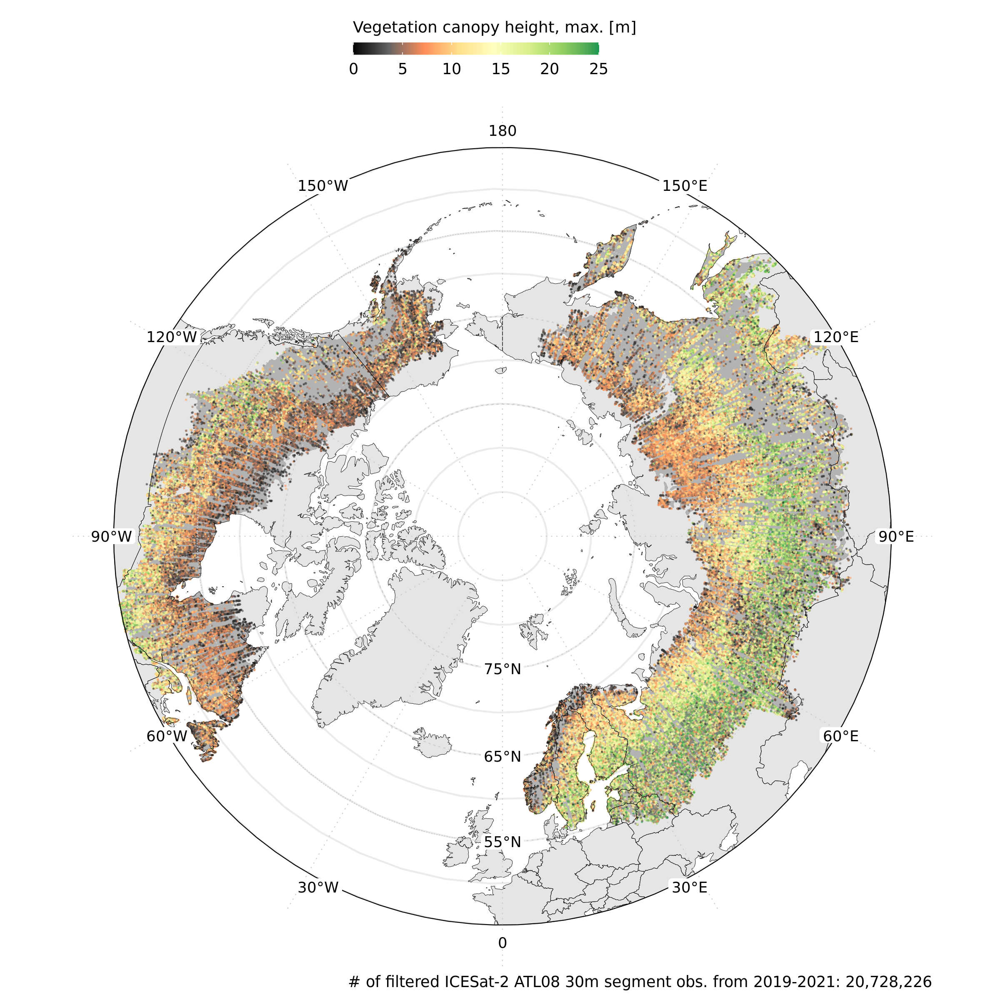

In [369]:
options(repr.plot.width = 8, repr.plot.height = 8, repr.plot.res = 300)


pal_ht = c('black','#636363','#fc8d59','#fee08b','#ffffbf','#d9ef8b','#91cf60','#1a9850')
min_lat = 45
year_atl08 = '2019-2021'

if(FALSE){
    df = atl08_sf %>% 
        as.data.frame() %>%
        #dplyr::filter(Y > min_lat, night_flg==1)
        dplyr::filter(Y > min_lat) # We use solar elev < 5
    }else{
    df = atl08 %>%
        dplyr::filter(lat > min_lat) 
}

NUM_ATL08_OBS = prettyNum(dim(df)[1],big.mark=",",scientific=FALSE)

# FRACTION
df = sample_frac(df, 0.01)


#NUM_ATL08_NIGHT_OBS = prettyNum(dim(atl08 %>% as.data.frame() %>% filter(night_flg==1))[1],big.mark=",",scientific=FALSE)

theme_and_labs = list(
    theme_classic(),
    theme(plot.subtitle=element_text(size=8, hjust=0.5, face="italic", color="black")),
    labs(
        #title="Vegetation canopy heights",
        #subtitle = paste0("Filtered sample of ICESat-2 ATL08 30m observations of RH98 in the boreal forest"," for ",year_atl08),
         #caption = paste0("# obs: ", NUM_ATL08_OBS, "\n# obs (night): ", NUM_ATL08_NIGHT_OBS)
         caption = paste0("# of filtered ICESat-2 ATL08 30m segment obs. from ", year_atl08,": ", NUM_ATL08_OBS)
    )    
)
scale_color_h_can = scale_colour_gradientn( breaks=c(0,5,10,15, 20, 25), limits = c(0,25), colours=pal_ht)


var_ht = 'h_can'

map_height_layer_list = list(
    geom_point(data = df, aes_string(x = "lon", y = "lat", colour=var_ht), alpha=0.5, size = 0.00001),
    scale_color_h_can,
    theme_and_labs,
    guides(color=guide_colourbar(title="Vegetation canopy height, max. [m]", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm")))
  )
m_ATL08_obs = DO_MAP_BOREAL_SP(MAP_EXTENT=extent(-180,180,min_lat,90), boreal_shp_fn = boreal_shp_fn, LAYER_LIST = map_height_layer_list)
m_ATL08_obs

## Export figure: ATL08 obs

In [370]:
DATA_NAME_STEM = "ATL08_obs_filt_boreal_clip"
EXPORT_TIME_STR = format(Sys.time(), "_%Y%m%d")

for(OUT_TYPE in c('png', 'pdf')){
    map_fn = path(OUT_FIGURE_DIR, paste0("map_",DATA_NAME_STEM,"_", var_ht, EXPORT_TIME_STR,".", OUT_TYPE))
    print(map_fn)
    ggsave(plot = m_ATL08_obs,
           file = map_fn,
           device = OUT_TYPE, dpi = 300, width = 6, height = 6)
}

/projects/my-public-bucket/boreal_polar_map/paper_figs/map_ATL08_obs_filt_boreal_clip_h_can_20230206.png
/projects/my-public-bucket/boreal_polar_map/paper_figs/map_ATL08_obs_filt_boreal_clip_h_can_20230206.pdf


In [ ]:
#writeOGR(atl08, path(out_dir, paste0(DATA_NAME_STEM,"_", EXPORT_TIME_STR), layer=DATA_NAME_STEM, driver="GeoJSON")
st_write(atl08, path(out_dir, paste0(DATA_NAME_STEM,"_", EXPORT_TIME_STR, ".gpkg"), DATA_NAME_STEM)

## Read the ICESat-2 ATL08 AGB training CSVs

In [49]:
AGB_tindex_master$s3_path_train = with(tindex_AGB_tindex_mastermaster, stringi::stri_replace_all_fixed(s3_path, '.tif', "_train_data.csv"))
head(AGB_tindex_master)

,X,s3_path,local_path,file,tile_num,s3_path_train
,<int>,<chr>,<chr>,<chr>,<int>,<chr>
1,52,s3://maap-ops-workspace/lduncanson/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/05/42/01/342476/boreal_agb_202302151676439579_1326.tif,/projects/my-private-bucket/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/05/42/01/342476/boreal_agb_202302151676439579_1326.tif,boreal_agb_202302151676439579_1326.tif,1326,s3://maap-ops-workspace/lduncanson/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/05/42/01/342476/boreal_agb_202302151676439579_1326_train_data.csv
2,51,s3://maap-ops-workspace/lduncanson/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/04/37/27/666751/boreal_agb_202302151676435792_3402.tif,/projects/my-private-bucket/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/04/37/27/666751/boreal_agb_202302151676435792_3402.tif,boreal_agb_202302151676435792_3402.tif,3402,s3://maap-ops-workspace/lduncanson/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/04/37/27/666751/boreal_agb_202302151676435792_3402_train_data.csv
3,50,s3://maap-ops-workspace/lduncanson/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/04/37/07/664247/boreal_agb_202302151676435665_3417.tif,/projects/my-private-bucket/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/04/37/07/664247/boreal_agb_202302151676435665_3417.tif,boreal_agb_202302151676435665_3417.tif,3417,s3://maap-ops-workspace/lduncanson/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/04/37/07/664247/boreal_agb_202302151676435665_3417_train_data.csv
4,49,s3://maap-ops-workspace/lduncanson/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/04/16/33/261650/boreal_agb_202302151676434536_3215.tif,/projects/my-private-bucket/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/04/16/33/261650/boreal_agb_202302151676434536_3215.tif,boreal_agb_202302151676434536_3215.tif,3215,s3://maap-ops-workspace/lduncanson/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/04/16/33/261650/boreal_agb_202302151676434536_3215_train_data.csv
5,48,s3://maap-ops-workspace/lduncanson/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/04/15/13/780147/boreal_agb_202302151676434460_3035.tif,/projects/my-private-bucket/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/04/15/13/780147/boreal_agb_202302151676434460_3035.tif,boreal_agb_202302151676434460_3035.tif,3035,s3://maap-ops-workspace/lduncanson/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/04/15/13/780147/boreal_agb_202302151676434460_3035_train_data.csv
6,47,s3://maap-ops-workspace/lduncanson/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/03/50/37/623710/boreal_agb_202302151676432986_2782.tif,/projects/my-private-bucket/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/03/50/37/623710/boreal_agb_202302151676432986_2782.tif,boreal_agb_202302151676432986_2782.tif,2782,s3://maap-ops-workspace/lduncanson/dps_output/run_boreal_biomass_quick_v2_ubuntu/map_boreal_2022_rh_noground_v4/2023/02/15/03/50/37/623710/boreal_agb_202302151676432986_2782_train_data.csv


## Create, Save, Read the training ATL08 AGB obs
#### Read in our set of training data CSV tiles

In [50]:
s3read_and_get_tilenum <- function(x){
    # Read table and make column with tile_num
    df = aws.s3::s3read_using(fread, object = x)
    # Use filename to get tile
    df$tile_num = strsplit(basename(x), '_')[[1]][4]
    return(df)
}

In [51]:
if(FALSE){
    AGB_tindex_master_sub = AGB_tindex_master %>% filter(tile_num != 3020) # A very pregnant LD deleted the *train_data.csv file for this tile..
    # Create this file once here and save
    atl08_agb_train = do.call(rbind, lapply(
        AGB_tindex_master_sub$s3_path_train, 
        #head(AGB_tindex_master_sub, 100)$s3_path_train, #<-- for testing
        function(x) s3read_and_get_tilenum(x)
        ))
    write_feather(atl08_agb_train, path = '/projects/my-public-bucket/boreal_polar_map/tables/atl08_agb_train_tiles.feather')
}else{
    # Read the file here
    atl08_agb_train = read_feather('/projects/my-public-bucket/boreal_polar_map/tables/atl08_agb_train_tiles.feather')
}
print(paste0('Total training ATL08 AGB obs for ', dim(AGB_tindex_master)[1],' tiles of boreal domain: ', dim(atl08_agb_train)[1]))
head(atl08_agb_train)

[1] "Total training ATL08 AGB obs for 4925 tiles of boreal domain: 41706828"


lon,lat,AGB,SE,tile_num
<dbl>,<dbl>,<dbl>,<dbl>,<chr>
-76.30155,51.08907,13.203188,0.001203251,1326
-79.01183,50.97245,3.883445,0.001075272,1326
-76.39731,50.45832,4.300709,0.001075272,1326
-76.30844,50.44268,43.302773,0.001203251,1326
-77.45645,52.03146,2.341350,0.001075272,1326
-77.68919,50.53604,39.789331,0.001203251,1326


In [52]:
smry_tile_train = atl08_agb_train %>% 
    dplyr::mutate(tile_num = as.numeric(tile_num)) %>%
    dplyr::group_by(tile_num) %>%
    dplyr::summarize(n_obs = n())
write.csv(smry_tile_train, file = '/projects/my-public-bucket/boreal_polar_map/tables/smry_atl08_agb_train_tiles.csv')
head(smry_tile_train)

tile_num,n_obs
<dbl>,<int>
4,8773
9,8773
10,8773
11,8773
12,8773
13,8773


In [29]:
boreal_tiles_gcs_ATL08obs_AGBtrain = boreal_tiles_gcs %>% 
    dplyr::mutate(tile_num = as.numeric(tile_num)) %>% 
    dplyr::left_join(smry_tile_train, by = c('tile_num' = 'tile_num'))
head(boreal_tiles_gcs_ATL08obs_AGBtrain)

,long,lat,order,hole,piece,id,group,tile_num,tile_version,tile_group,map_version,n_obs
,<dbl>,<dbl>,<int>,<lgl>,<fct>,<chr>,<fct>,<dbl>,<chr>,<chr>,<chr>,<int>
1,4.624619,56.64562,1,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA
2,5.390977,57.33162,2,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA
3,6.672362,56.91323,3,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA
4,5.890771,56.23471,4,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA
5,4.624619,56.64562,5,FALSE,1,1,1.1,1,version 1,eurasia west,NA,NA
6,3.329813,57.04317,1,FALSE,1,2,2.1,2,version 1,eurasia west,NA,NA


OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



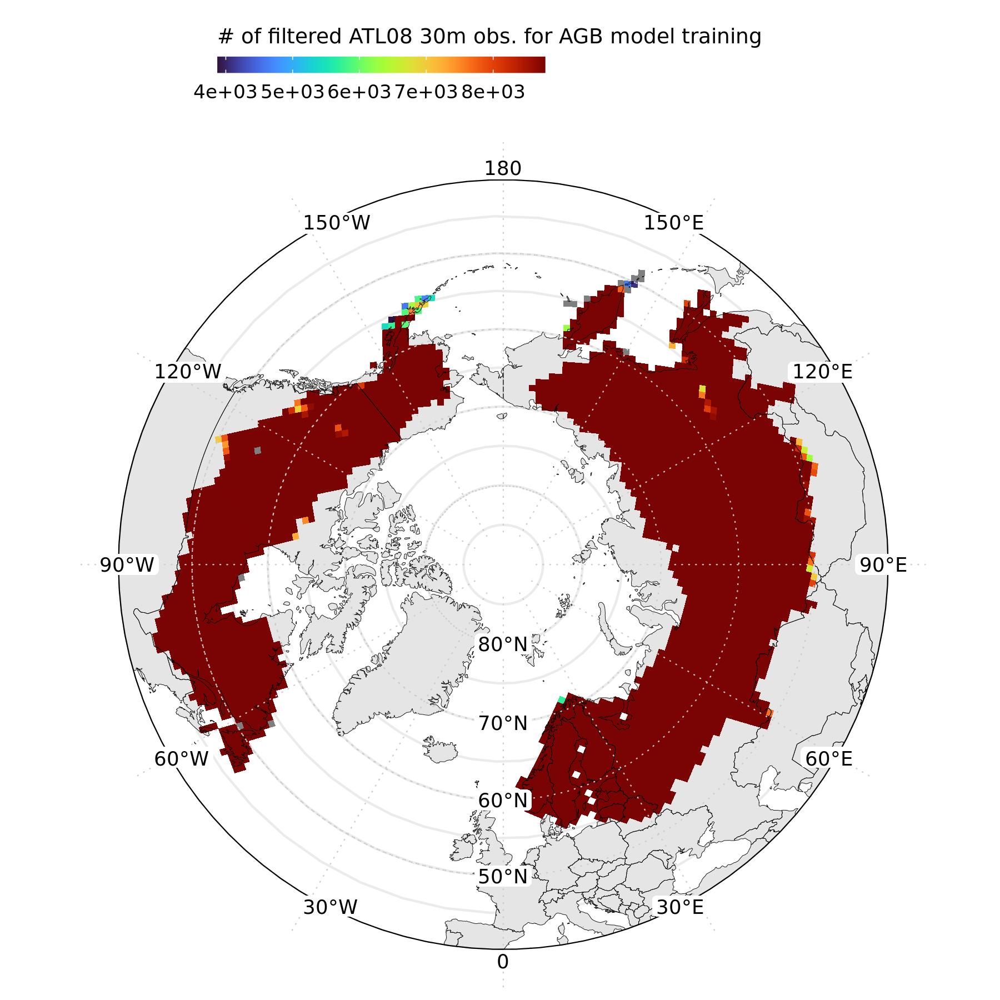

In [30]:
options(repr.plot.width = 6, repr.plot.height = 6, repr.plot.res = 300)
# Show map of HLS compositing params

m_ATL08obs_AGBtrain_tile = DO_MAP_BOREAL_SP(MAP_EXTENT=ext,  
                     boreal_shp_fn = boreal_shp_fn,
                     LAYER_LIST = list(geom_polygon(data = boreal_tiles_gcs_ATL08obs_AGBtrain %>% dplyr::filter(tile_num %in% boreal_tile_num_list), 
                                                    aes(x = long, y = lat, group = group, fill=n_obs), size=0.1)
                                      )
                    ) + 
    theme(legend.text=element_text(size=rel(0.75))) +
    guides(fill=guide_colourbar(title="# of filtered ATL08 30m obs. for AGB model training", title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm")))+
    scale_fill_viridis(option = 'turbo', labels = scientific)

m_ATL08obs_AGBtrain_tile

### Clip the training ATL08 AGB obs to boreal - NO - instead use the clipped ATL08 hts, and join AGB to that

In [ ]:
# atl08_agb_train = st_intersection(st_as_sf(
#                                 sample_frac(
#                                             #do.call(rbind, lapply(files_boreal$s3_path, function(x) fread(x, stringsAsFactors = TRUE))), 
#                                             do.call(rbind, lapply(AGB_tindex_master$s3_path_train, function(x) s3read_and_get_tilenum(x) )),
#                                             0.01
#                                             ),
#                                 coords = c('lon', 'lat') , 
#                                 crs = "+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs"), 
#                         #boreal # intersect ATL08 with boreal extent
#                         boreal_tiles_clip # intersect ATL08 with boreal tiles extent
#                                 )
# atl08_agb_train = as(cbind(atl08_agb_train, st_coordinates(atl08_agb_train)), 'Spatial')    

In [ ]:
#options(repr.plot.width = 10, repr.plot.height = 3, repr.plot.res = 300)
#library(forcats)
#ggplot(atl08_agb_train, aes(x=fct_infreq(tile_num))) + geom_bar(stat="count") + theme(axis.text.x = element_blank())

## Plot training ATL08 AGB obs

In [ ]:
options(repr.plot.width = 8, repr.plot.height = 8, repr.plot.res = 300)


MAX_AGB = 125
min_lat = 45
year_atl08 = '2019-2021'

if(FALSE){
    df = atl08_agb_train_sf %>% 
        as.data.frame() %>%
        #dplyr::filter(Y > min_lat, night_flg==1)
        dplyr::filter(Y > min_lat) # We use solar elev < 5
}else{
    df = atl08_agb_train %>%
        dplyr::filter(lat > min_lat) 
}

NUM_ATL08_TRAINOBS = prettyNum(dim(df)[1],big.mark=",",scientific=FALSE)

# FRACTION
df = st_intersection(st_as_sf(
                        sample_frac(df, 0.001)
                                ,
                                coords = c('lon', 'lat') , 
                                remove = FALSE,
                                crs = "+proj=longlat +ellps=WGS84 +datum=WGS84 +no_defs"), 
                        #boreal # intersect ATL08 with boreal extent
                        boreal_tiles_clip # intersect ATL08 with boreal tiles extent
                                ) %>%
                        as.data.frame()

#NUM_ATL08_NIGHT_OBS = prettyNum(dim(atl08 %>% as.data.frame() %>% filter(night_flg==1))[1],big.mark=",",scientific=FALSE)

theme_and_labs = list(
    theme_classic(),
    theme(plot.subtitle=element_text(size=8, hjust=0.5, face="italic", color="black")),
    labs(
        #title="Vegetation canopy heights",
        #subtitle = paste0("Filtered sample of ICESat-2 ATL08 30m observations of RH98 in the boreal forest"," for ",year_atl08),
         #caption = paste0("# obs: ", NUM_ATL08_OBS, "\n# obs (night): ", NUM_ATL08_NIGHT_OBS)
         #caption = paste0("# of ICESat-2 ATL08 30m segment AGB training obs. from ", year_atl08,": ", NUM_ATL08_TRAINOBS)
    )    
)


var_ht = "AGB"

map_AGB_layer_list = list(
    geom_point(data = df, aes_string(x = "lon", y = "lat", colour="AGB"), alpha=0.5, size = 0.00001),
    scale_color_gradientn(limits = c(0,MAX_AGB), breaks = seq(0,MAX_AGB,25), colours = viridis(10) ),
    theme_and_labs,
    guides(color=guide_colourbar(title=expression("Mean of aboveground biomass density ["~Mg~ha^{-1}~"]"), title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm")))
  )
m_AGBtrain_obs = DO_MAP_BOREAL_SP(MAP_EXTENT=extent(-180,180,min_lat,90), boreal_shp_fn = boreal_shp_fn, LAYER_LIST = map_AGB_layer_list)
m_AGBtrain_obs

### Map AGB mean and AGB std
##### Using a raster that gets reprojected

In [19]:
#r = raster('/projects/shared-buckets/alexdevseed/icesat2_boreal_biomass_900m.tif', band=1)
r_fn = '/projects/shared-buckets/nathanmthomas/DPS_tile_lists/07/AGB_tindex_average_3000m.tif'
r_fn = '/projects/shared-buckets/nathanmthomas/DPS_tile_lists/AGB/fall2022/map_boreal_2022_v3/11/AGB_tindex_average_3000m.tif'
r_fn = '/projects/shared-buckets/nathanmthomas/DPS_tile_lists/AGB/winter2023/map_boreal_2022_rh_noground_v4/AGB_tindex_average_4500m.tif'
r_agb_mean = raster(r_fn, band=1)
r_agb_std = raster(r_fn, band=2)
names(r_agb_mean) = 'mean_agb'
names(r_agb_std) = 'std_agb'

#plot(r_agb_mean)
#plot(r_agb_std)

Warning message in showSRID(SRS_string, format = "PROJ", multiline = "NO", prefer_proj = prefer_proj):
“Discarded datum unknown in Proj4 definition”
Warning message in showSRID(SRS_string, format = "PROJ", multiline = "NO", prefer_proj = prefer_proj):
“Discarded datum unknown in Proj4 definition”


#### Convert raster to points, sample

In [20]:
df_list = list()
for(r in c(r_agb_mean, r_agb_std)){
    
    # Convert to df 
    r_p <- sample_frac(data.frame(rasterToPoints(r)), 0.05) #0.01 sample is good for draft work
    
    names(r_p) = c('x','y','value')
    r_p$variable = names(r)
    
    df_list[[names(r)]] = r_p
    rm(r_p)
}
r_p = do.call('rbind', df_list)
rownames(r_p) = NULL
dim(r_p)

[1] 161874      4

#### Do intersection to clip to vector, reproject to GCS, return data frame

In [21]:
r_geo_p =  as_Spatial( 
                    st_intersection(st_as_sf(r_p, coords = c('x','y') , crs = crs_canalb), st_as_sf(boreal_albers) %>% select(REALM)) %>% 
                    st_transform(crs = crs_gcs)
                    )%>% 
            as.data.frame()
# names(r_geo_p)[1] = "value"
names(r_geo_p)[length(names(r_geo_p))-1] = "x"
names(r_geo_p)[length(names(r_geo_p))] = "y"
class(r_geo_p)
tail(r_geo_p)

Warning message:
“attribute variables are assumed to be spatially constant throughout all geometries”


[1] "data.frame"

,value,variable,REALM,x,y
,<dbl>,<chr>,<chr>,<dbl>,<dbl>
161863,6.9773331,std_agb,PA,16.23038,61.92756
161864,28.9156265,std_agb,PA,104.12934,53.39150
161866,2.0286987,std_agb,PA,113.84419,68.03876
161869,7.4928913,std_agb,PA,108.62885,48.80931
161872,11.3229933,std_agb,PA,94.38591,54.58734
161874,0.8860646,std_agb,PA,144.93602,62.43768


[1] 91038     5

OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



OGR data source with driver: GeoJSON 
Source: "/projects/shared-buckets/nathanmthomas/analyze_agb/input_zones/wwf_circumboreal_Dissolve.geojson", layer: "wwf_circumboreal_Dissolve"
with 2 features
It has 4 fields


Regions defined for each Polygons

Regions defined for each Polygons

Regions defined for each Polygons



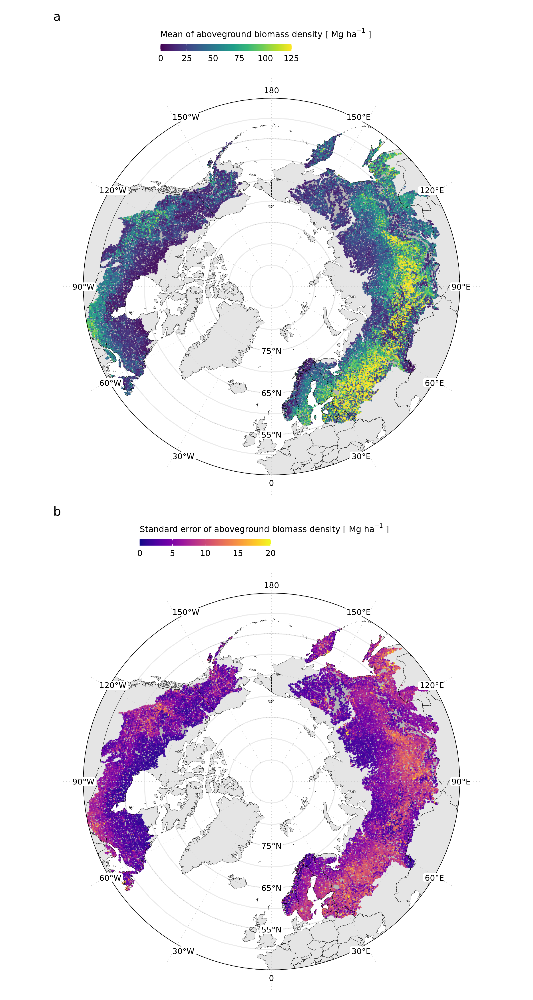

In [24]:
options(repr.plot.width =8, repr.plot.height =15, repr.plot.res = 300)

map_extent = extent(-180, 180, 45, 90)
min_lat = map_extent[3]
MAX_AGB = 125
MAX_STD = 20
year_agb = '2020'
VERSION = 'v2.3' #summer 2022
dim(r_geo_p)

theme_and_labs = list(
    theme_classic(),
    labs(
        #title="Circumpolar boreal forest aboveground biomass density",
        #subtitle = paste0("c. ",year_agb," 30 m resolution, provisional","\nData sources: ICESat-2, Landsat-8, Copernicus DEM"),
         #caption = paste0("# obs: ", NUM_ATL08_OBS, "\n# obs (night): ", NUM_ATL08_NIGHT_OBS)
         #caption = 'Arctic Boreal Vulnerability Experiment (ABoVE)\nNASA Goddard Space Flight Center\nU. of Maryland Dept. Geographical Sciences'
    )
)

agb_mean_layer_list = list( 
    geom_point(data = sample_frac(r_geo_p %>% dplyr::filter(variable == 'mean_agb'), 1) %>% 
               dplyr::filter(y > min_lat) %>%
               dplyr::mutate(value_adj = case_when(value > MAX_AGB ~ MAX_AGB, 
                                                   TRUE ~ value))
               , aes(x = x, y = y, color = value_adj), size = 0.1, alpha = 0.75),
    scale_color_gradientn(limits = c(0,MAX_AGB), breaks = seq(0,MAX_AGB,25), colours = viridis(10) ),
    guides(color=guide_colourbar(title=expression("Mean of aboveground biomass density ["~Mg~ha^{-1}~"]"), title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"))),
    theme_and_labs +
    facet_wrap(~variable)
    )

agb_std_layer_list = list( 
    geom_point(data = sample_frac(r_geo_p %>% dplyr::filter(variable == 'std_agb'), 1) %>% 
               dplyr::filter(y > min_lat) %>%
               dplyr::mutate(value_adj = case_when(value > MAX_STD ~ MAX_STD, 
                                                   TRUE ~ value))
               , aes(x = x, y = y, color = value_adj), size = 0.1, alpha = 0.75),
    scale_color_gradientn(limits = c(0,MAX_STD), breaks = seq(0,MAX_STD,5), colours = plasma(10) ),
    guides(color=guide_colourbar(title=expression("Standard error of aboveground biomass density ["~Mg~ha^{-1}~"]"), title.position = "top", label.position = "bottom", keywidth = unit(.5, "cm"), keyheight = unit(.25, "cm"))),
    theme_and_labs +
    facet_wrap(~variable)
    )

m_AGB_mean = DO_MAP_BOREAL_SP(MAP_EXTENT=map_extent, boreal_shp_fn = boreal_shp_fn, LAYER_LIST = agb_mean_layer_list)
m_AGB_std  = DO_MAP_BOREAL_SP(MAP_EXTENT=map_extent, boreal_shp_fn = boreal_shp_fn, LAYER_LIST = agb_std_layer_list)

                             
m_AGB_mean_std = (m_AGB_mean / m_AGB_std) +
          plot_annotation(tag_levels = "a")                   
                             
m_AGB_mean_std

#out_dir = dirname(r_fn)
#DATA_NAME_STEM = "AGB_boreal"
DATA_NAME_STEM = tools::file_path_sans_ext(basename(r_fn))
EXPORT_TIME_STR = format(Sys.time(), "_%Y%m%d")


## Export figure:
AGB mean and AGB std 

In [25]:
if(TRUE){
    for(OUT_TYPE in c('png', 'pdf')){

        map_fn = path(OUT_FIGURE_DIR, paste0("map_",DATA_NAME_STEM,"_", year_agb, EXPORT_TIME_STR,"_", VERSION, ".", OUT_TYPE))
        print(map_fn)
        ggsave(plot = m_AGB_mean_std,
                   file = map_fn,
                   device = OUT_TYPE, dpi = 300, width = 8, height = 15)
    }
}

/projects/my-public-bucket/boreal_polar_map/paper_figs/map_AGB_tindex_average_4500m_2020_20230210_v2.3.png
/projects/my-public-bucket/boreal_polar_map/paper_figs/map_AGB_tindex_average_4500m_2020_20230210_v2.3.pdf


## Use patchwork to arrange plots
https://patchwork.data-imaginist.com/

In [42]:
options(repr.plot.width =25, repr.plot.height =10, repr.plot.res = 300)

In [33]:
#m_hls_runname + m_hls_maxcloud + m_rmse + m_r2 + m_ATL08obs + guide_area() + plot_layout(ncol = 2, guides = "collect")
#m_pft

m_AGB | ( (m_hls_runname | m_hls_maxcloud) / (m_rmse | m_r2) / (m_ATL08obs | m_pft) ) + 
#plot_layout(ncol = 3) + 
plot_annotation(tag_levels = "a")

ERROR: Error in m_hls_runname | m_hls_maxcloud: operations are possible only for numeric, logical or complex types


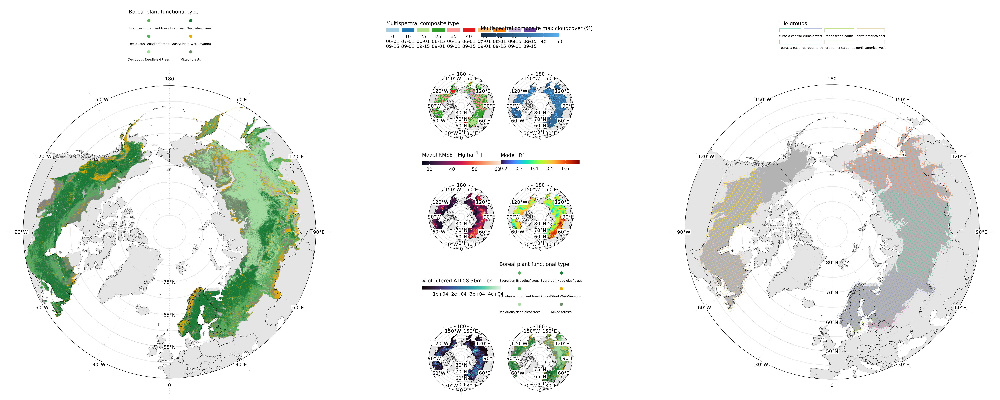

In [43]:
m_pft | ( (m_hls_runname | m_hls_maxcloud) / (m_rmse | m_r2) / (m_ATL08obs | m_pft) ) | m_groups + 
#plot_layout(ncol = 3) + 
plot_annotation(tag_levels = "a")